In [1]:
import cartopy.crs as ccrs
from matplotlib.colors import LogNorm
import matplotlib.pyplot as plt
import numpy as np
import osmnx as ox
import pandas as pd
import seaborn as sns
from sklearn.neighbors import KernelDensity

In [2]:
# Load the data
df = pd.read_pickle('data_cabspotting/cabspotting.pkl')

In [4]:
df.head()

latitude  longitude  occupied
user   time                                              
abboip 2008-05-17 14:12:10  37.75153 -122.39447         0
       2008-05-17 14:13:34  37.75149 -122.39447         0
       2008-05-17 14:14:34  37.75149 -122.39447         0
       2008-05-17 14:15:35  37.75149 -122.39446         0
       2008-05-17 14:41:43  37.75144 -122.39449         0

In [3]:
df_abboip = df.loc['abboip'].copy()

In [4]:
north, south, east, west = 38.04691, 37.276830000000004, -121.95391333333333, -122.62829

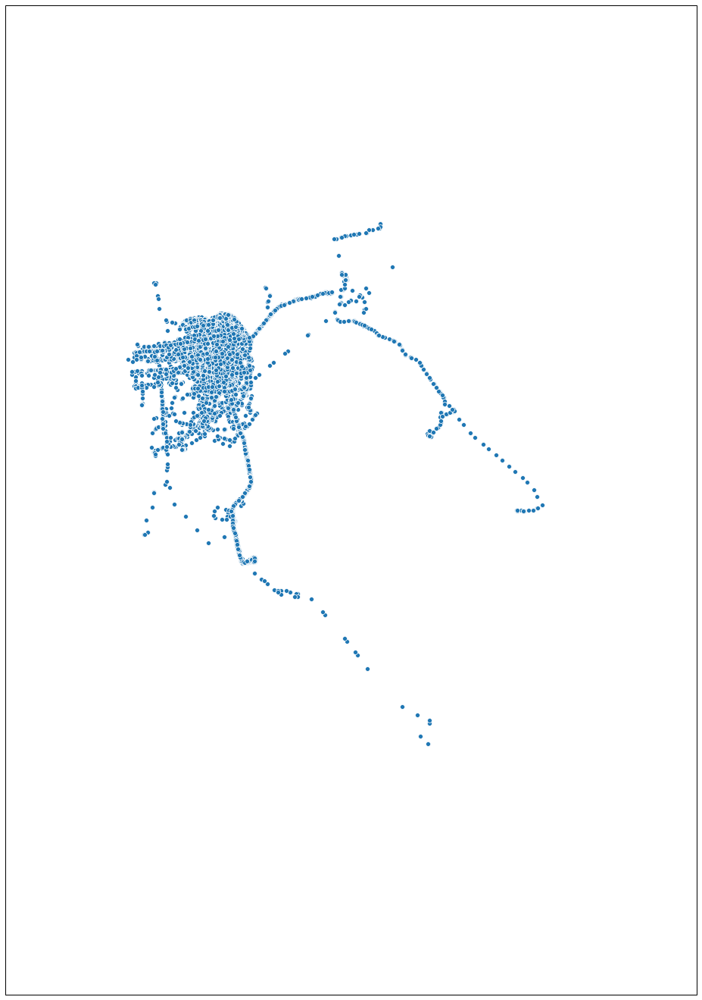

In [44]:
plt.figure(figsize=(24, 24))

ax = plt.axes(projection=ccrs.UTM(10))
ax.set_extent([west, east, south, north])

sns.scatterplot(df_abboip['longitude'], df_abboip['latitude'], transform=ccrs.PlateCarree())

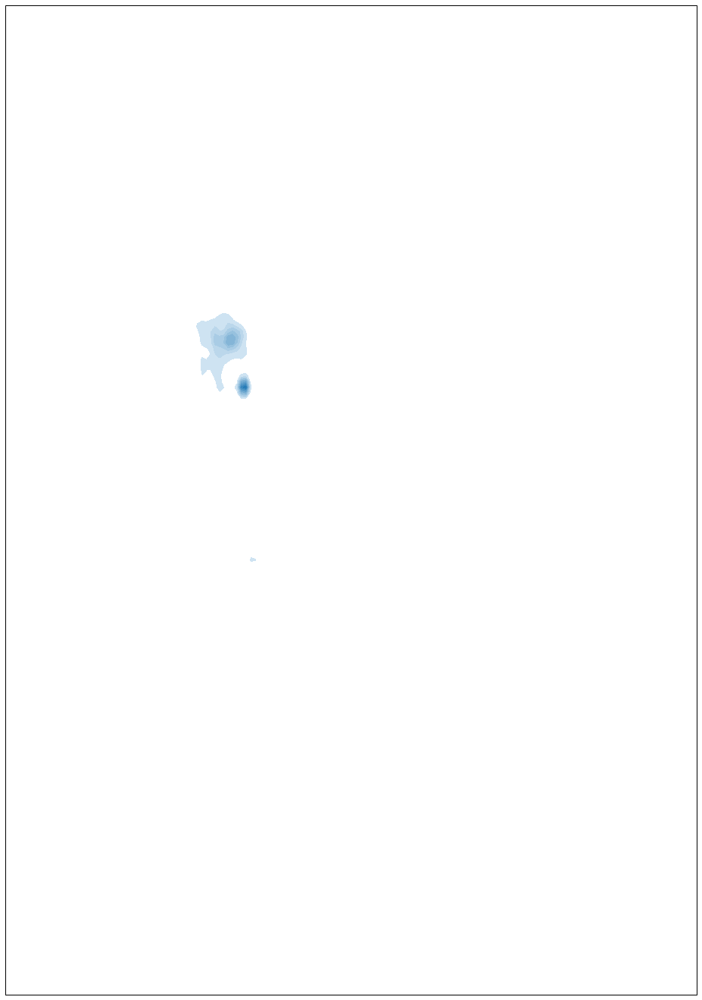

In [45]:
plt.figure(figsize=(24, 24))

ax = plt.axes(projection=ccrs.UTM(10))
ax.set_extent([west, east, south, north])

sns.kdeplot(df_abboip['longitude'], df_abboip['latitude'],
            shade=True, shade_lowest=False, transform=ccrs.PlateCarree())

In [5]:
# Load the OSMNX graph
streets = ox.load_graphml('cabspotting_streets_all.graphml', folder='osmnx_data')

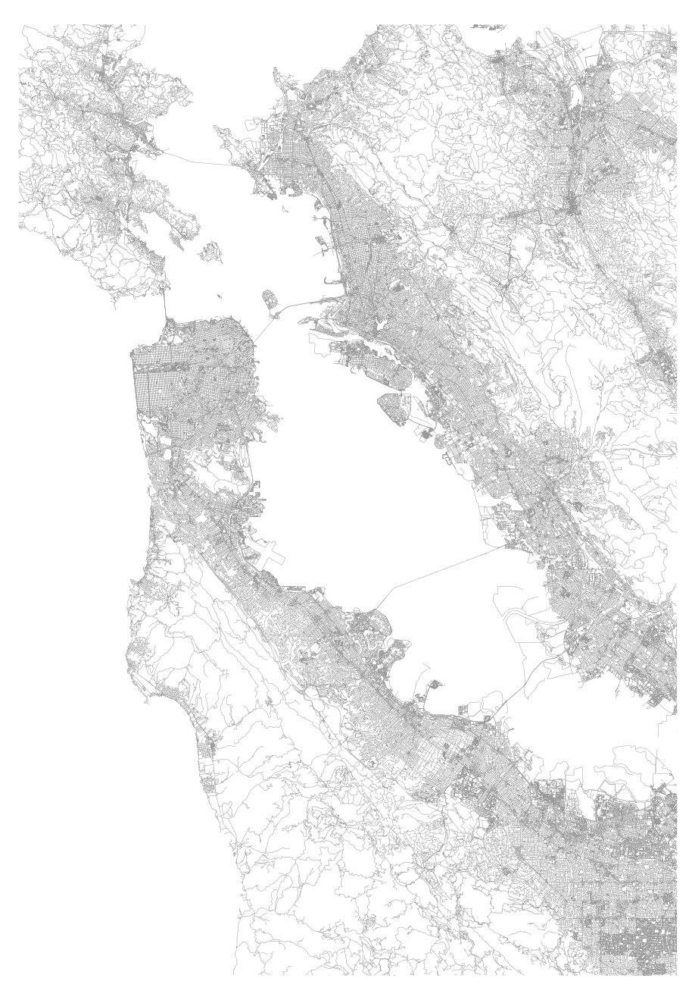

(<Figure size 1513.26x1728 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x3e7046d68>)

In [43]:
ox.plot_graph(streets, fig_height=24, node_size=0, edge_linewidth=0.25)

In [6]:
# Load the small OSMNX graph
streets_small = ox.load_graphml('san_francisco_streets_all.graphml', folder='osmnx_data')

In [7]:
sf_edges = ox.graph_to_gdfs(streets_small, nodes=False, fill_edge_geometry=True)
sf_west, sf_south, sf_east, sf_north = sf_edges.total_bounds
print(sf_west, sf_south, sf_east, sf_north)

-122.5142828 37.708132 -122.3499854 37.8322456


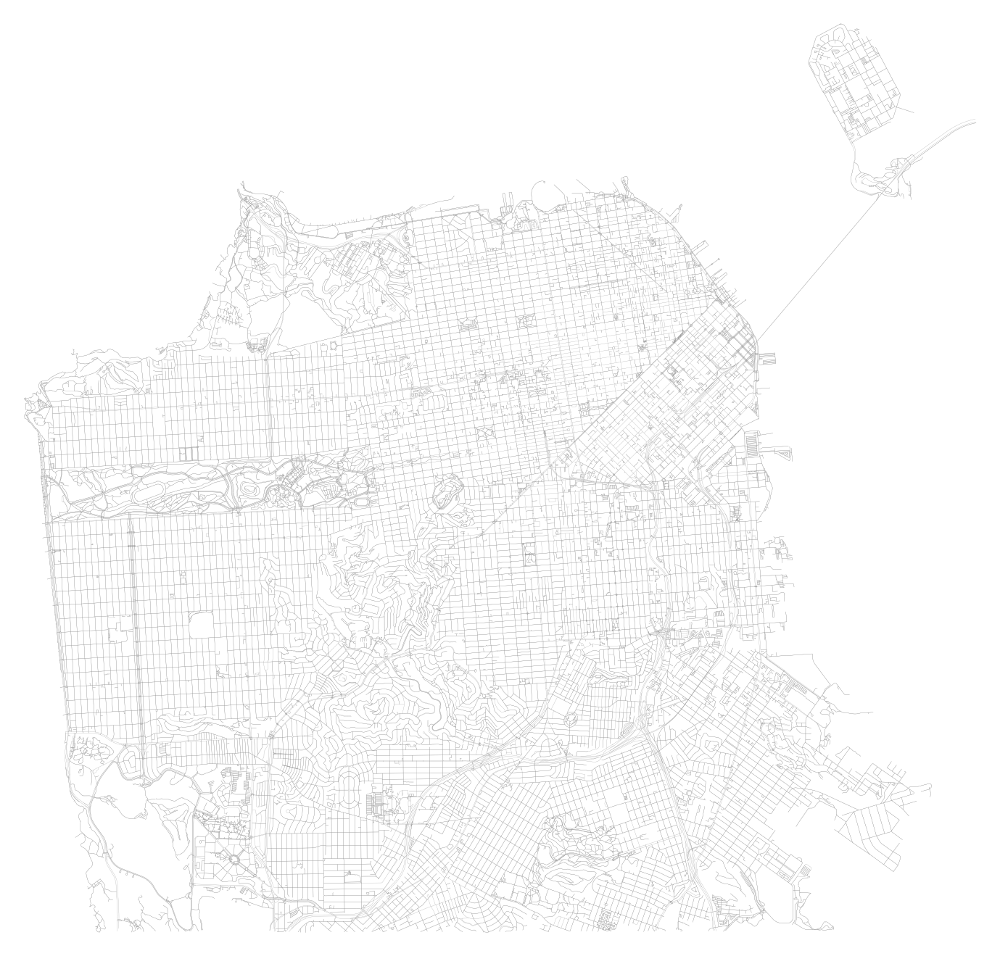

(<Figure size 2287.47x1728 with 1 Axes>,
 <matplotlib.axes._subplots.AxesSubplot at 0x3eb26d470>)

In [101]:
ox.plot_graph(streets_small, fig_height=24, node_size=0, edge_linewidth=0.25)

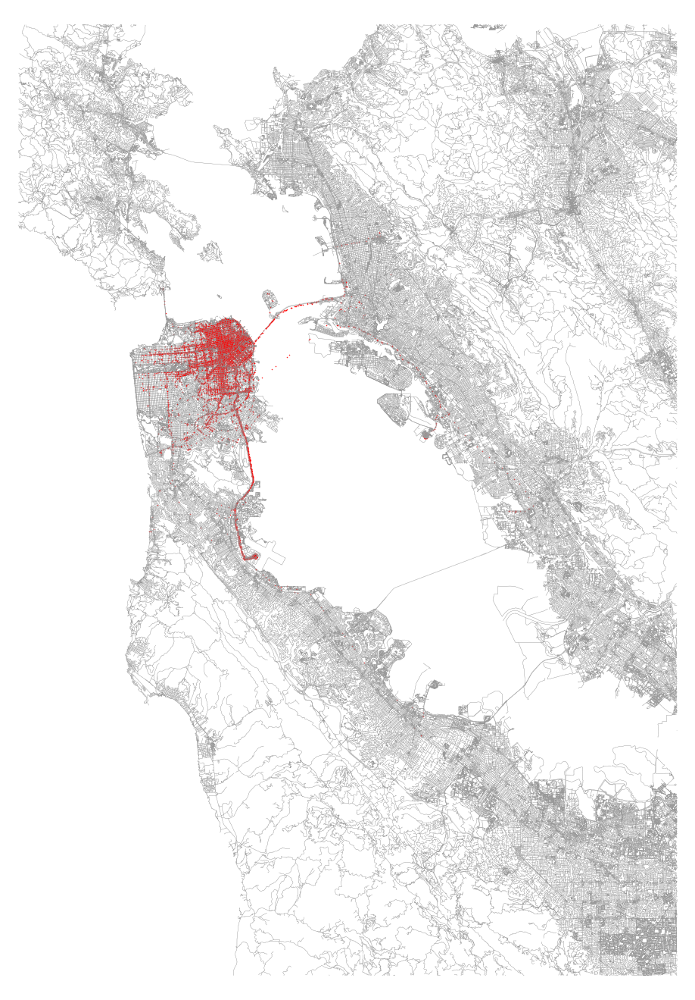

In [62]:
fig, ax = ox.plot_graph(streets, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
ax.scatter(df_abboip['longitude'], df_abboip['latitude'], c='#ff0000', s=0.25, alpha=1.0)

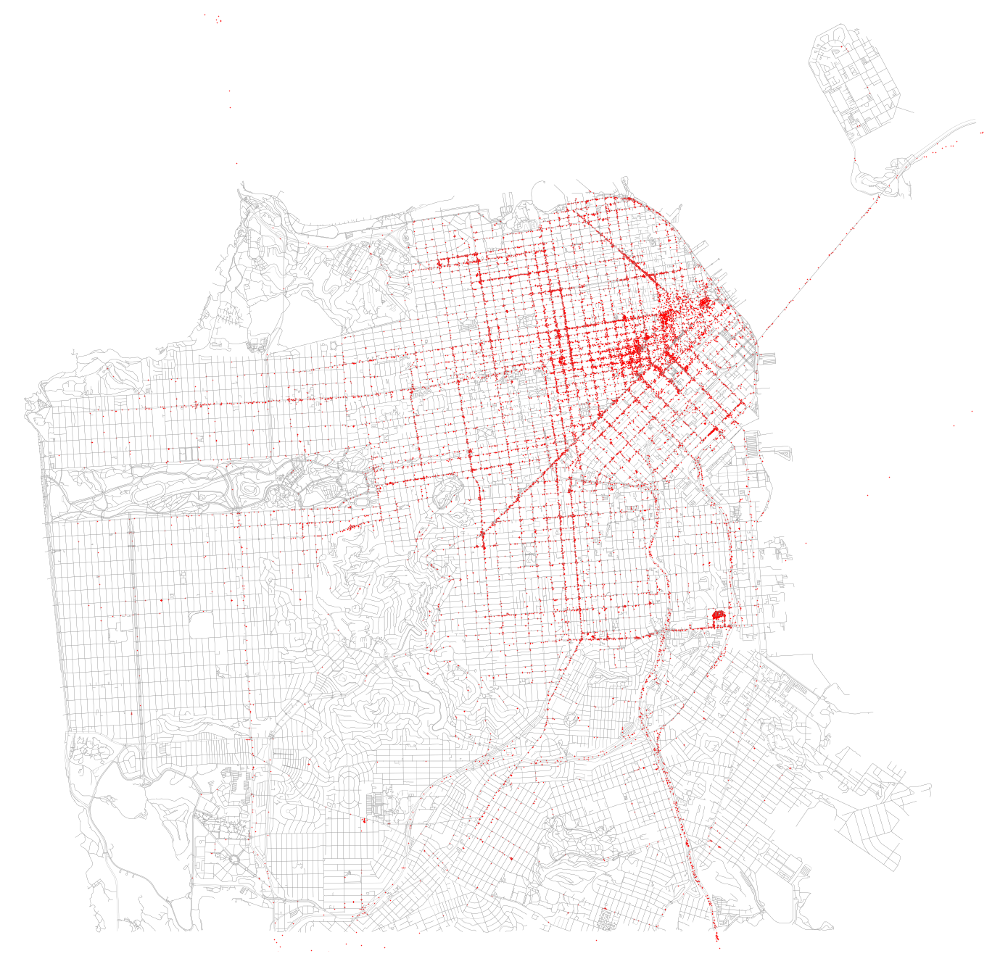

In [102]:
fig, ax = ox.plot_graph(streets_small, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
ax.scatter(df_abboip['longitude'], df_abboip['latitude'], c='#ff0000', s=0.25, alpha=1.0)

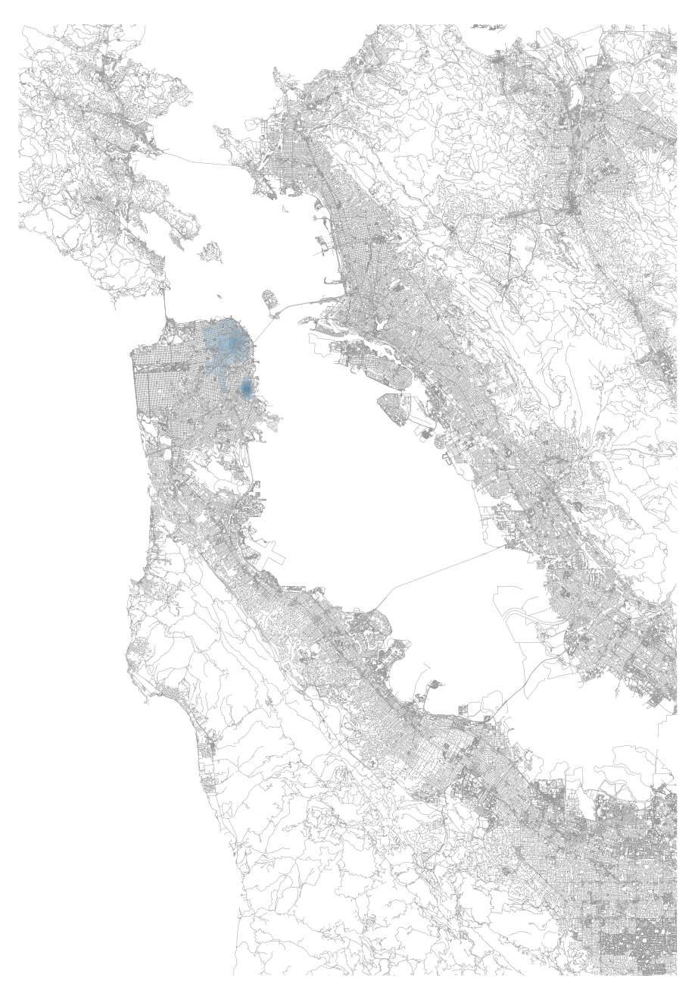

In [63]:
fig, ax = ox.plot_graph(streets, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
sns.kdeplot(df_abboip['longitude'], df_abboip['latitude'],
            shade=True, shade_lowest=False, ax=ax)

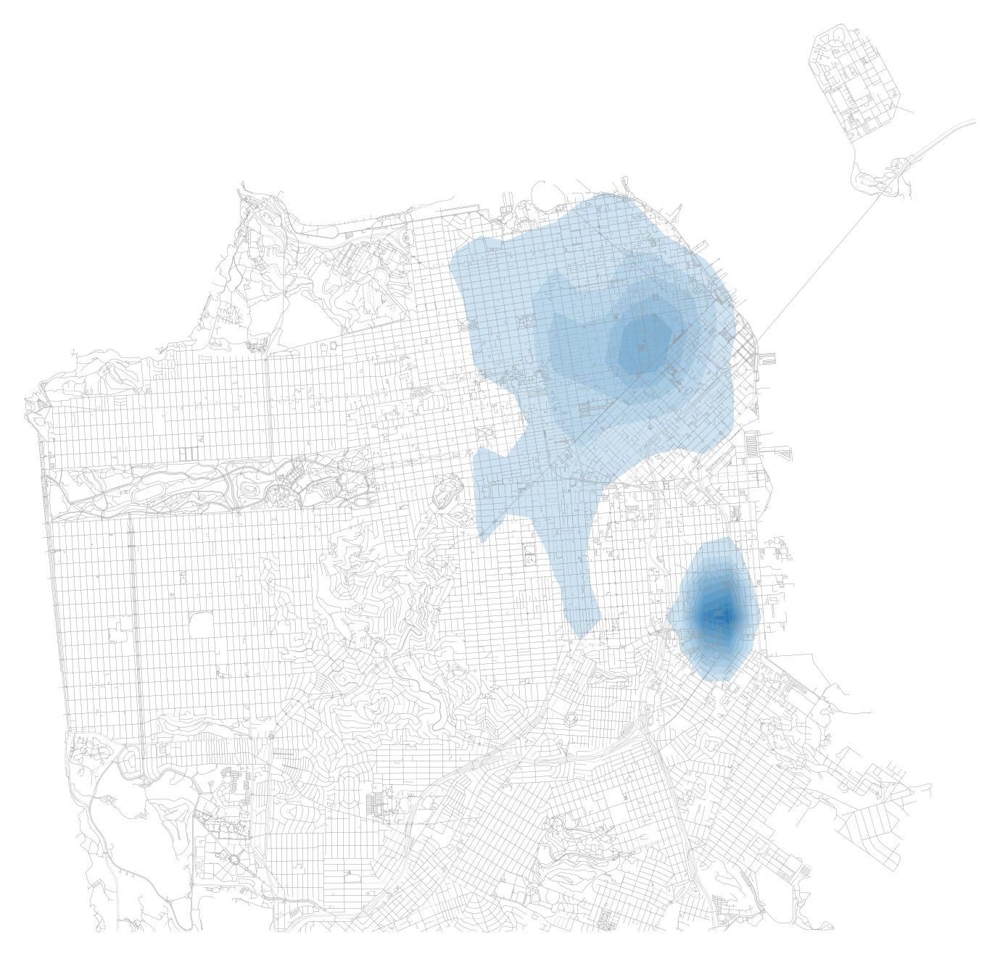

In [103]:
fig, ax = ox.plot_graph(streets_small, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
sns.kdeplot(df_abboip['longitude'], df_abboip['latitude'],
            shade=True, shade_lowest=False, ax=ax)

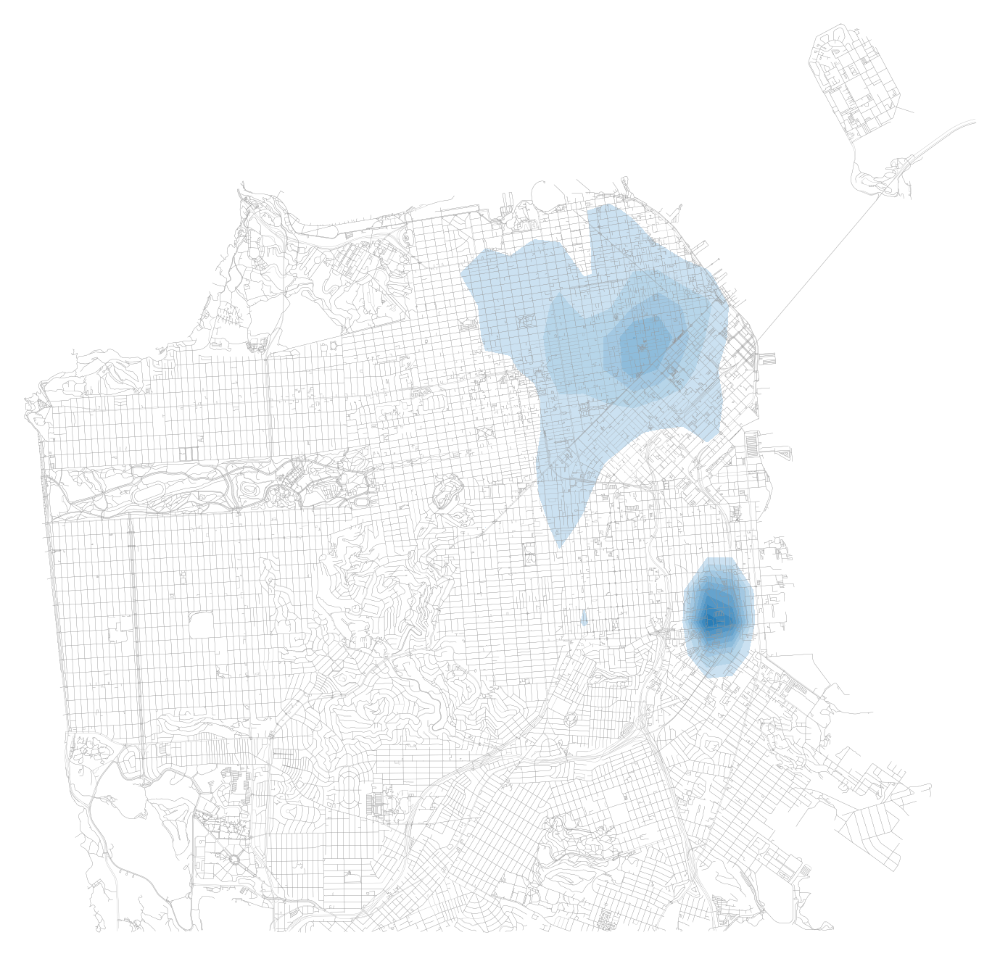

In [7]:
fig, ax = ox.plot_graph(streets_small, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
sns.kdeplot(df_abboip['longitude'], df_abboip['latitude'],
            shade=True, shade_lowest=False, ax=ax, bw='silverman')

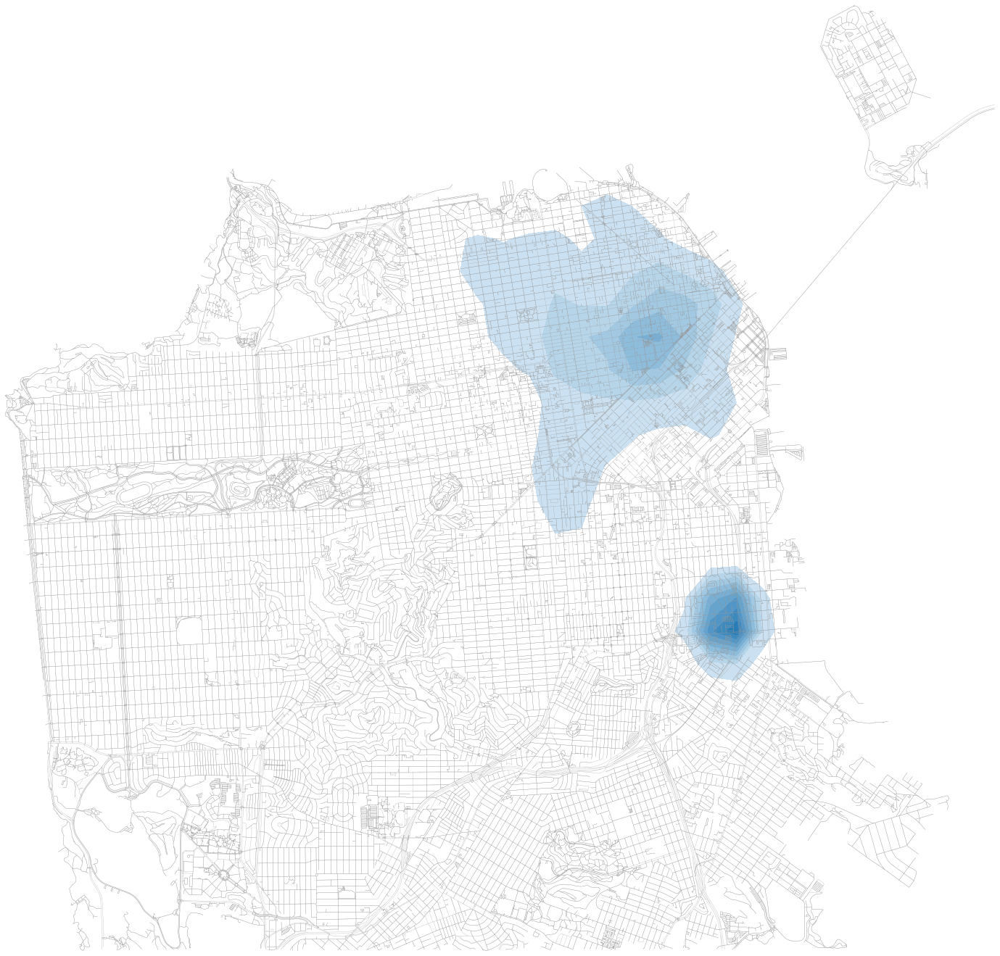

In [8]:
fig, ax = ox.plot_graph(streets_small, fig_height=24, node_size=0, edge_linewidth=0.25, margin=0.0,
                        show=False, close=False)
sns.kdeplot(df_abboip['longitude'], df_abboip['latitude'],
            shade=True, shade_lowest=False, ax=ax, bw=0.003)

plt.savefig('../Images/overview_cabspotting_abboip_kde.png', dpi=100, bbox_inches='tight')

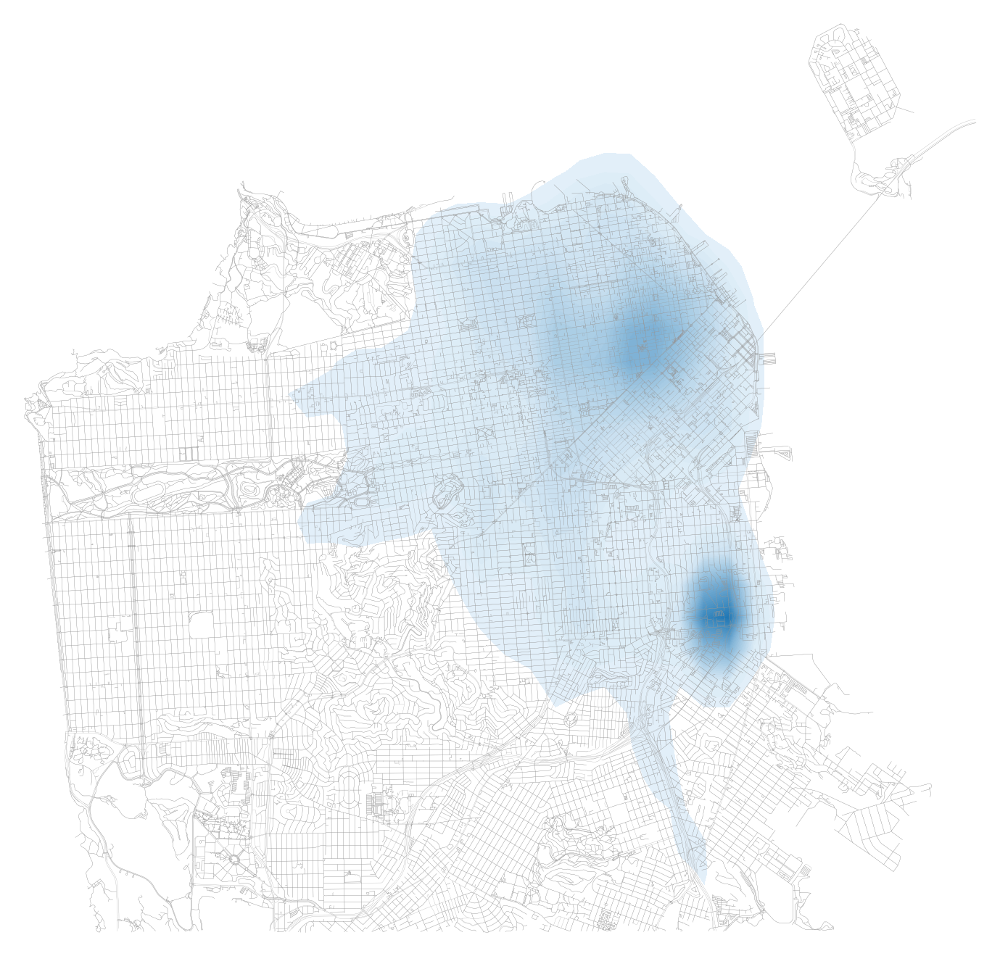

In [7]:
fig, ax = ox.plot_graph(streets_small, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
sns.kdeplot(df_abboip['longitude'], df_abboip['latitude'],
            shade=True, shade_lowest=False, ax=ax, n_levels=50)

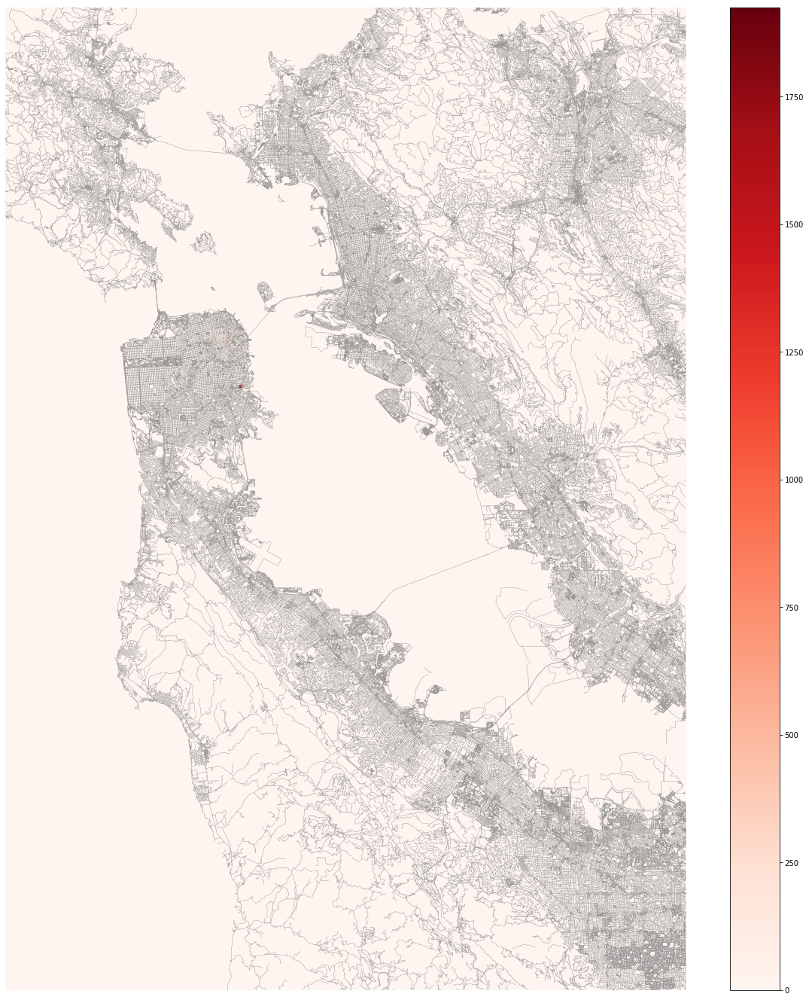

In [117]:
fig, ax = ox.plot_graph(streets, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
plt.hist2d(df_abboip['longitude'], df_abboip['latitude'],
           bins=(300, 300), cmap=plt.cm.Reds, range=[[west, east], [south, north]])
plt.colorbar()

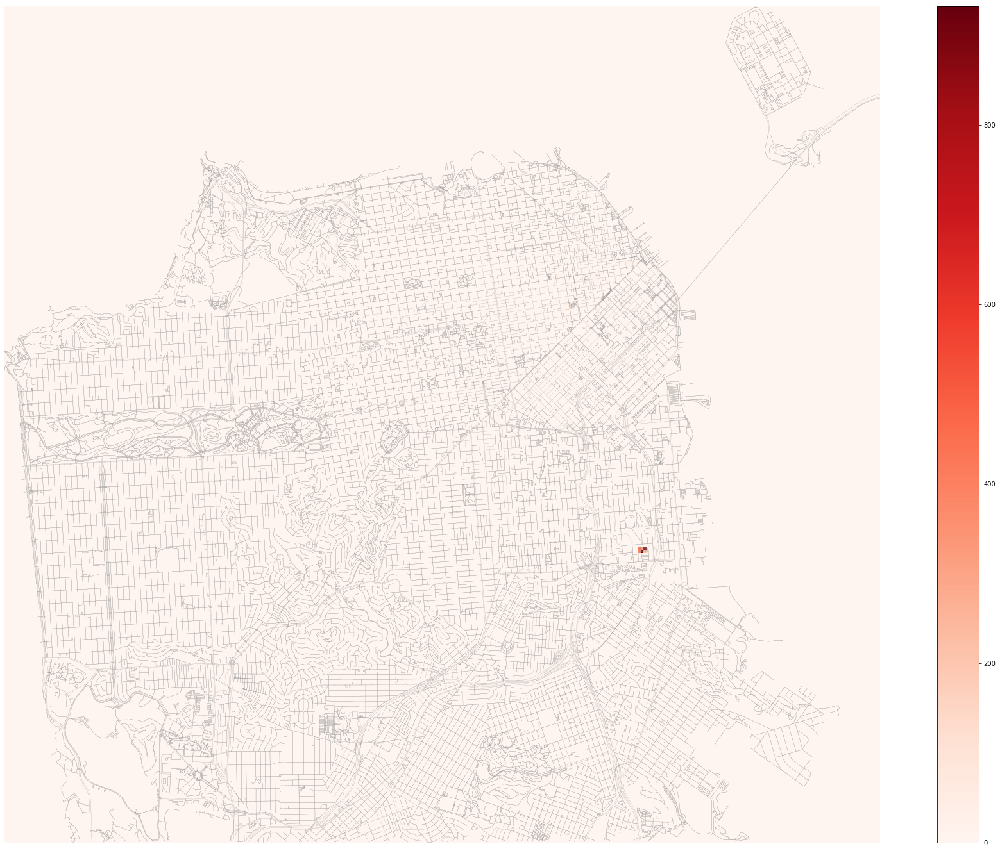

In [19]:
fig, ax = ox.plot_graph(streets_small, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
plt.hist2d(df_abboip['longitude'], df_abboip['latitude'],
           bins=(300, 300), cmap=plt.cm.Reds, range=[[sf_west, sf_east], [sf_south, sf_north]])
plt.colorbar()

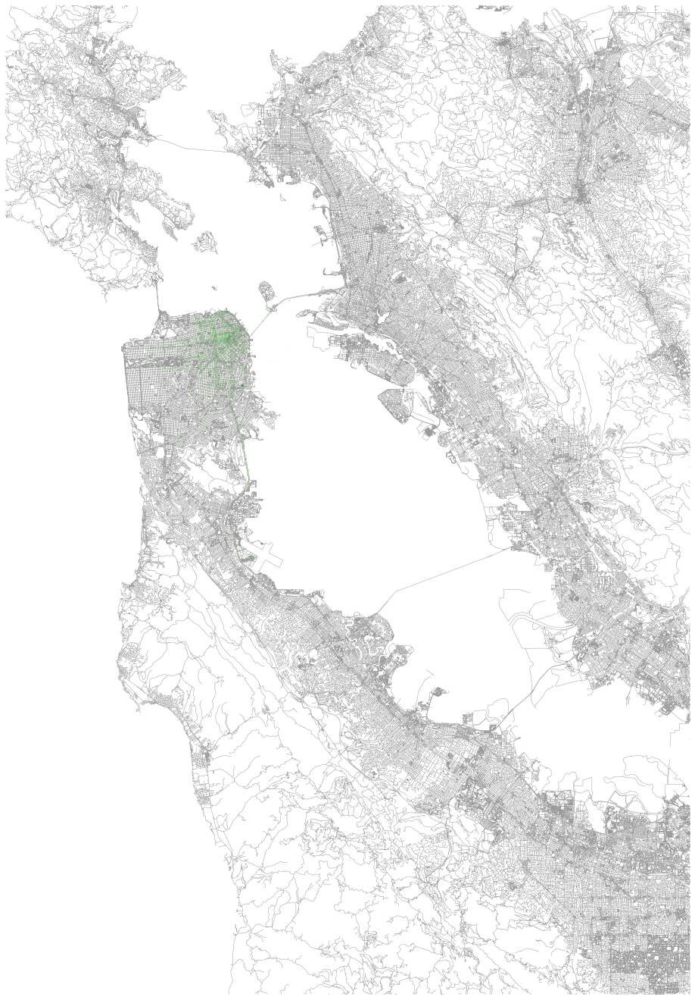

In [17]:
fig, ax = ox.plot_graph(streets, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
plt.hist2d(df_abboip['longitude'], df_abboip['latitude'],
           bins=(600, 860), cmap=plt.cm.Greens, range=[[west, east], [south, north]], norm=LogNorm())
plt.show()

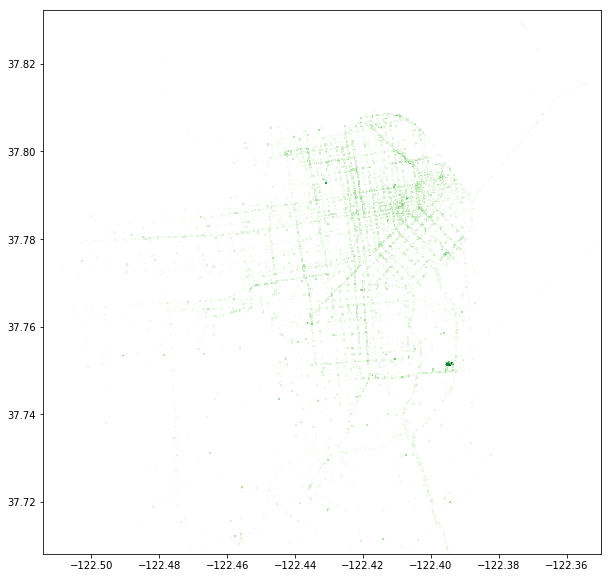

In [18]:
plt.figure(figsize=(10, 10))
plt.hist2d(df_abboip['longitude'], df_abboip['latitude'],
           bins=500, range=[[sf_west, sf_east], [sf_south, sf_north]], cmap=plt.cm.Greens, norm=LogNorm())
plt.show()

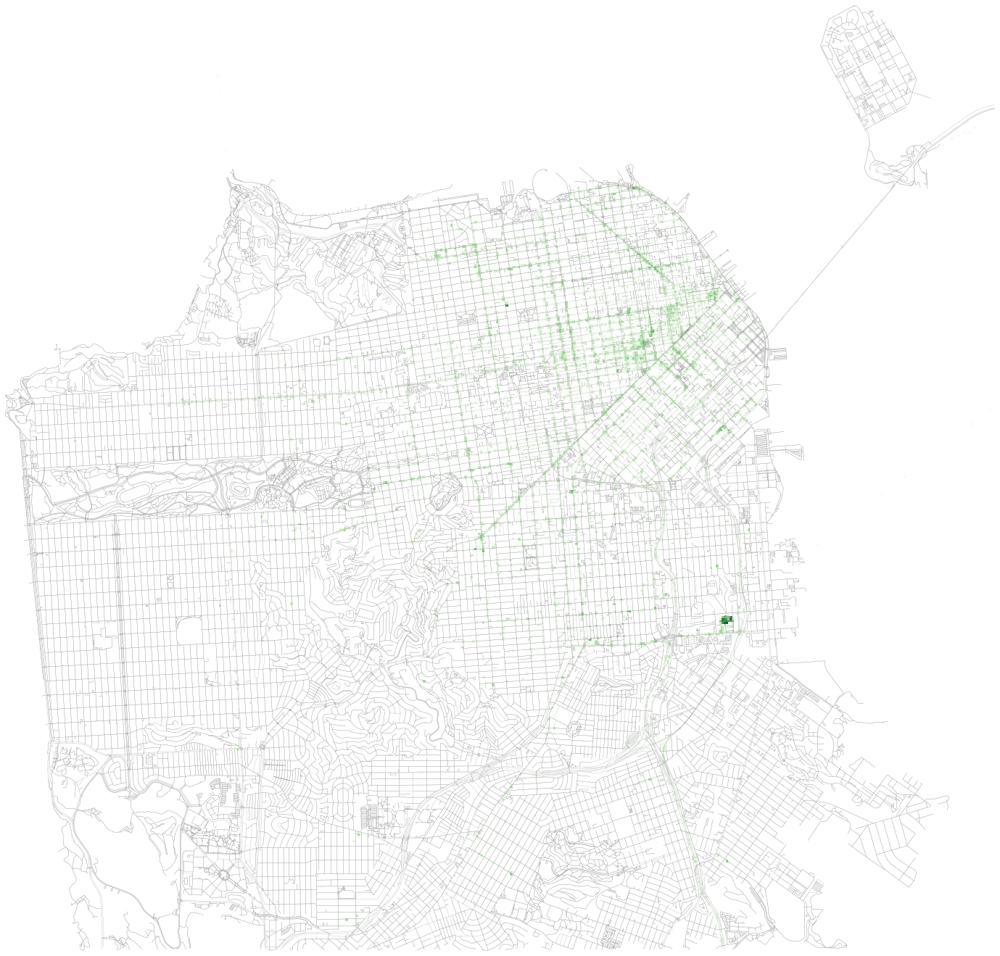

In [15]:
fig, ax = ox.plot_graph(streets_small, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
plt.hist2d(df_abboip['longitude'], df_abboip['latitude'],
           bins=500, cmap=plt.cm.Greens, range=[[sf_west, sf_east], [sf_south, sf_north]], norm=LogNorm())
plt.show()

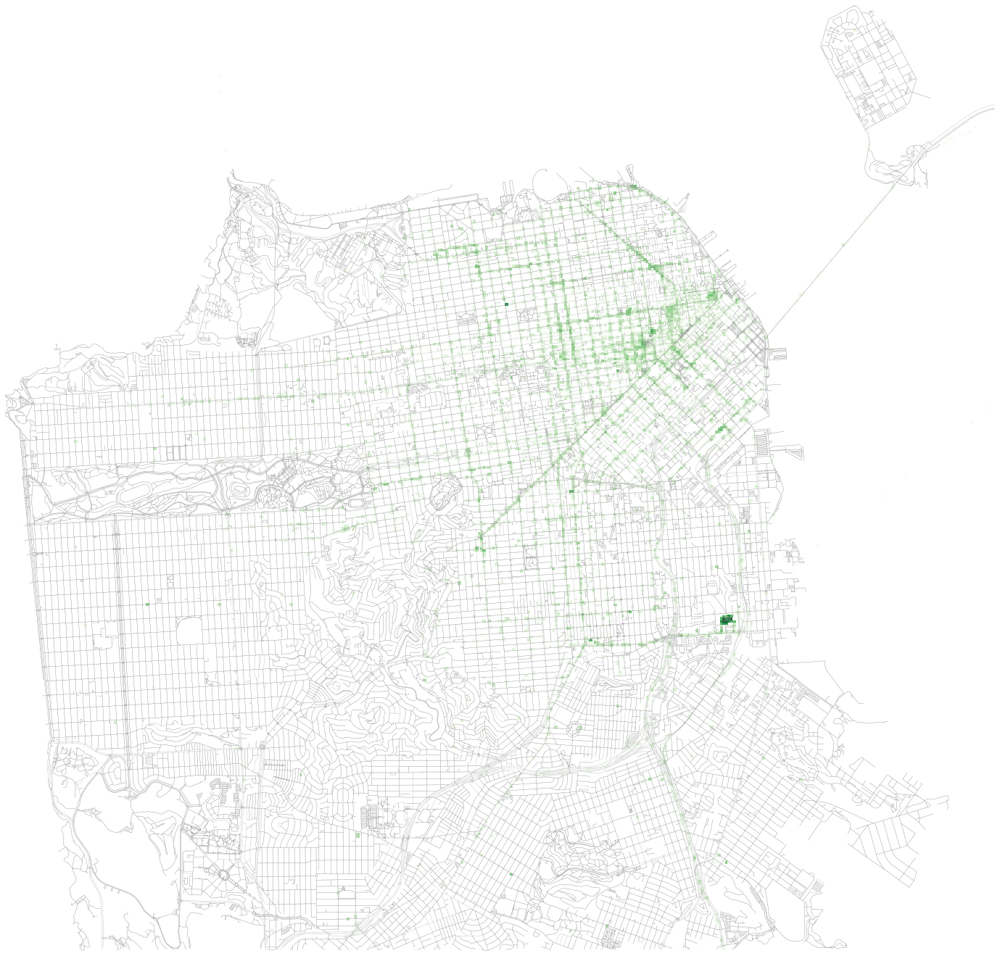

In [14]:
fig, ax = ox.plot_graph(streets_small, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
plt.hist2d(df_abboip['longitude'], df_abboip['latitude'],
           bins=400, cmap=plt.cm.Greens, range=[[sf_west, sf_east], [sf_south, sf_north]], norm=LogNorm())
plt.show()

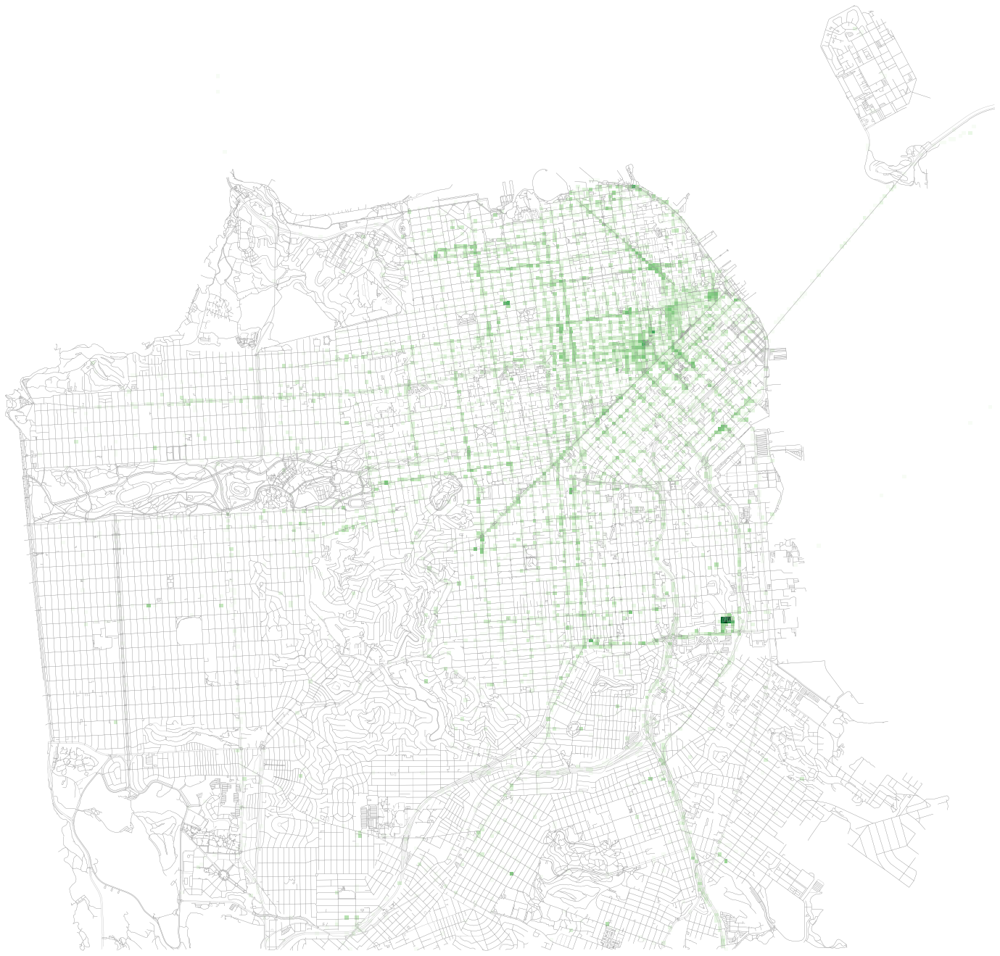

In [13]:
fig, ax = ox.plot_graph(streets_small, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
plt.hist2d(df_abboip['longitude'], df_abboip['latitude'],
           bins=300, cmap=plt.cm.Greens, range=[[sf_west, sf_east], [sf_south, sf_north]], norm=LogNorm())
plt.show()

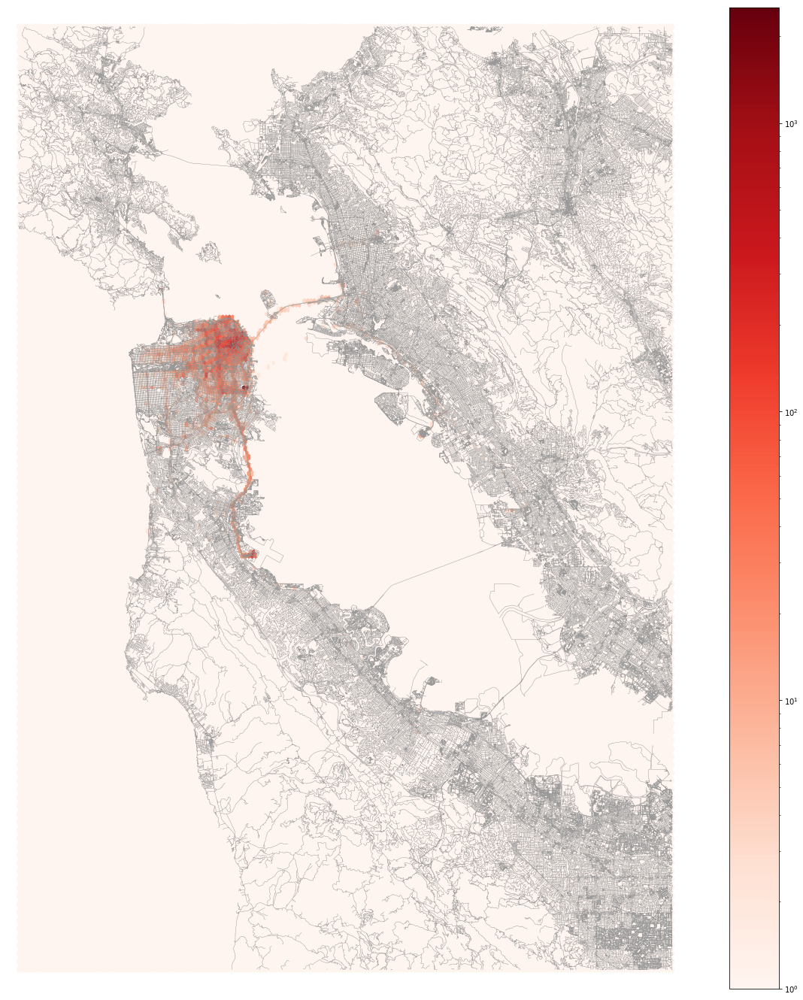

In [16]:
fig, ax = ox.plot_graph(streets, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
plt.hexbin(df_abboip['longitude'], df_abboip['latitude'],
           gridsize=200, cmap=plt.cm.Reds, extent=[west, east, south, north], norm=LogNorm())
plt.colorbar()

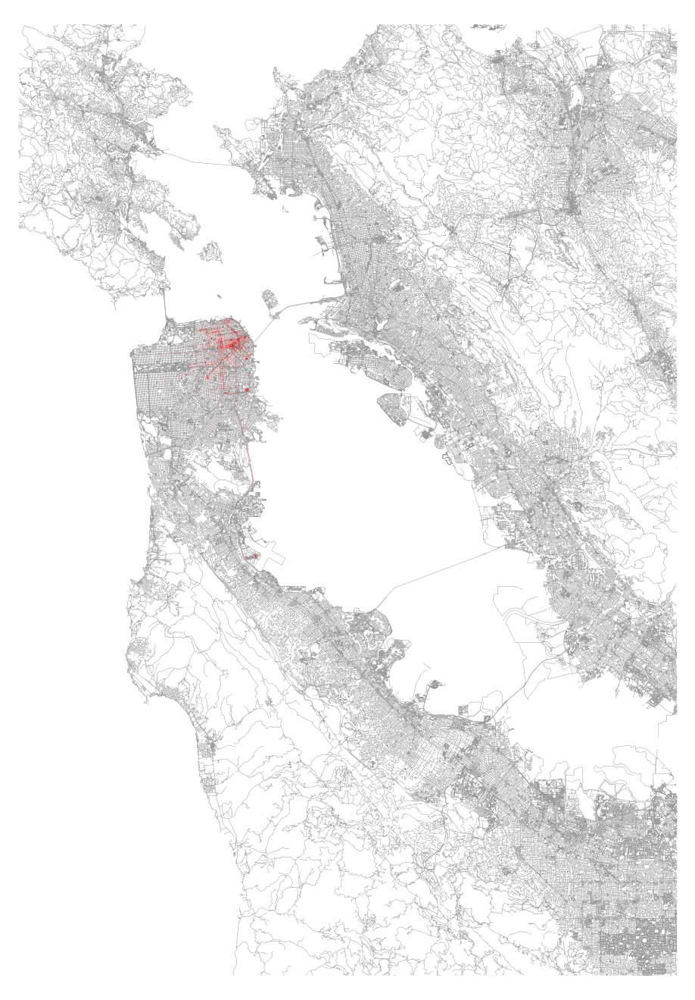

In [7]:
fig, ax = ox.plot_graph(streets, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
ax.scatter(df_abboip['longitude'], df_abboip['latitude'], c='#ff0000', s=0.25, alpha=0.05)

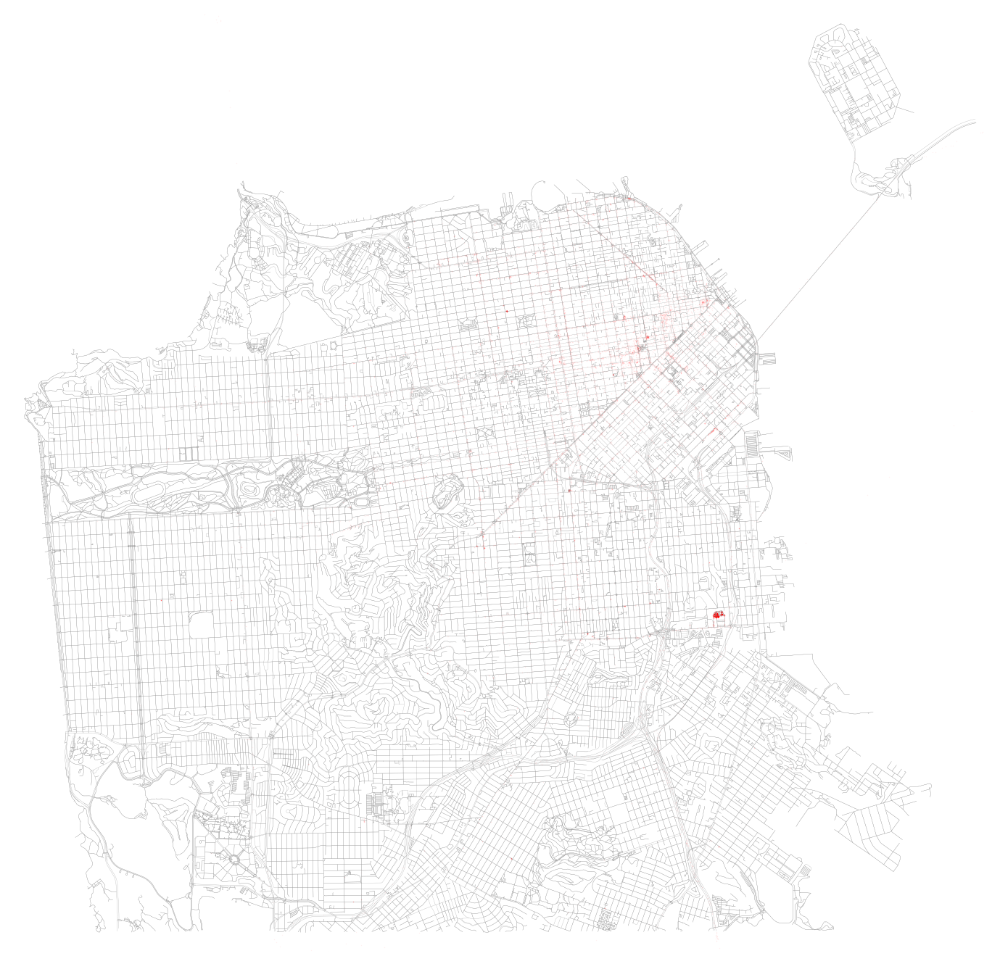

In [8]:
fig, ax = ox.plot_graph(streets_small, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
ax.scatter(df_abboip['longitude'], df_abboip['latitude'], c='#ff0000', s=0.25, alpha=0.05)

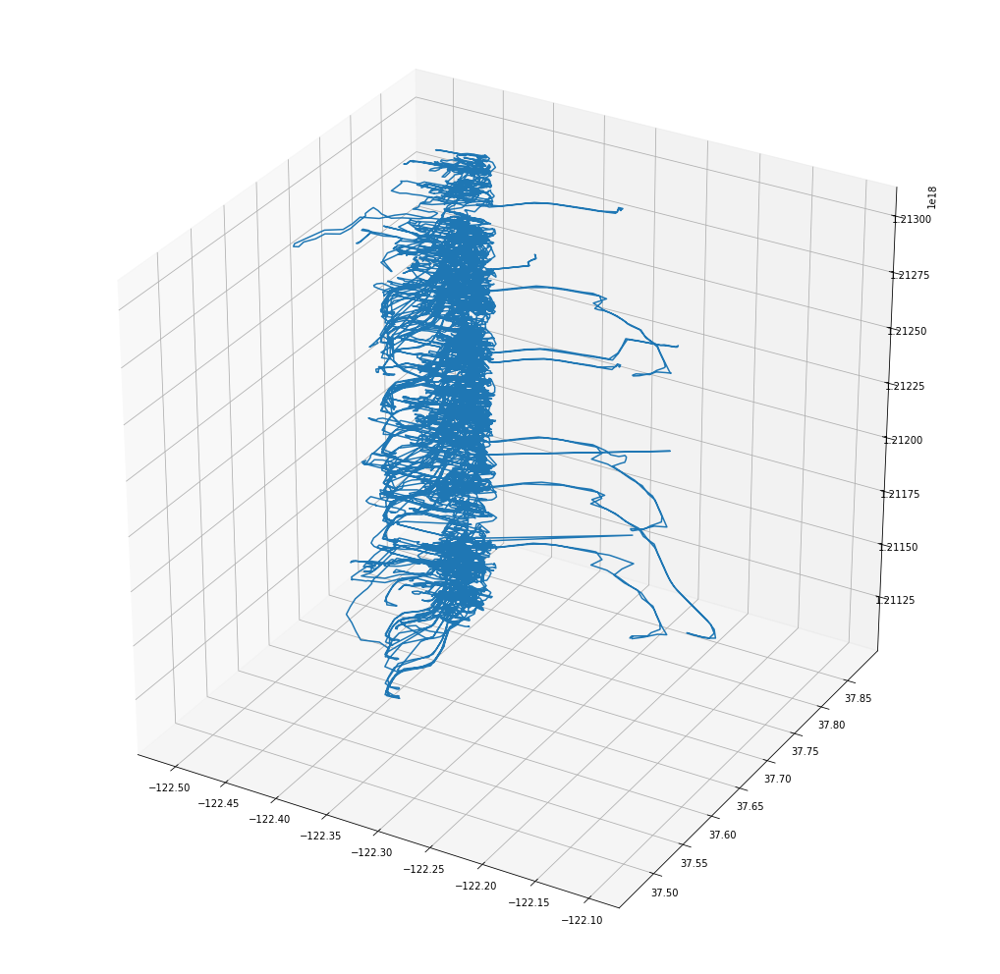

In [78]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(18, 18))
ax = fig.gca(projection='3d')
ax.plot(df_abboip['longitude'], df_abboip['latitude'], df_abboip.index.to_series())

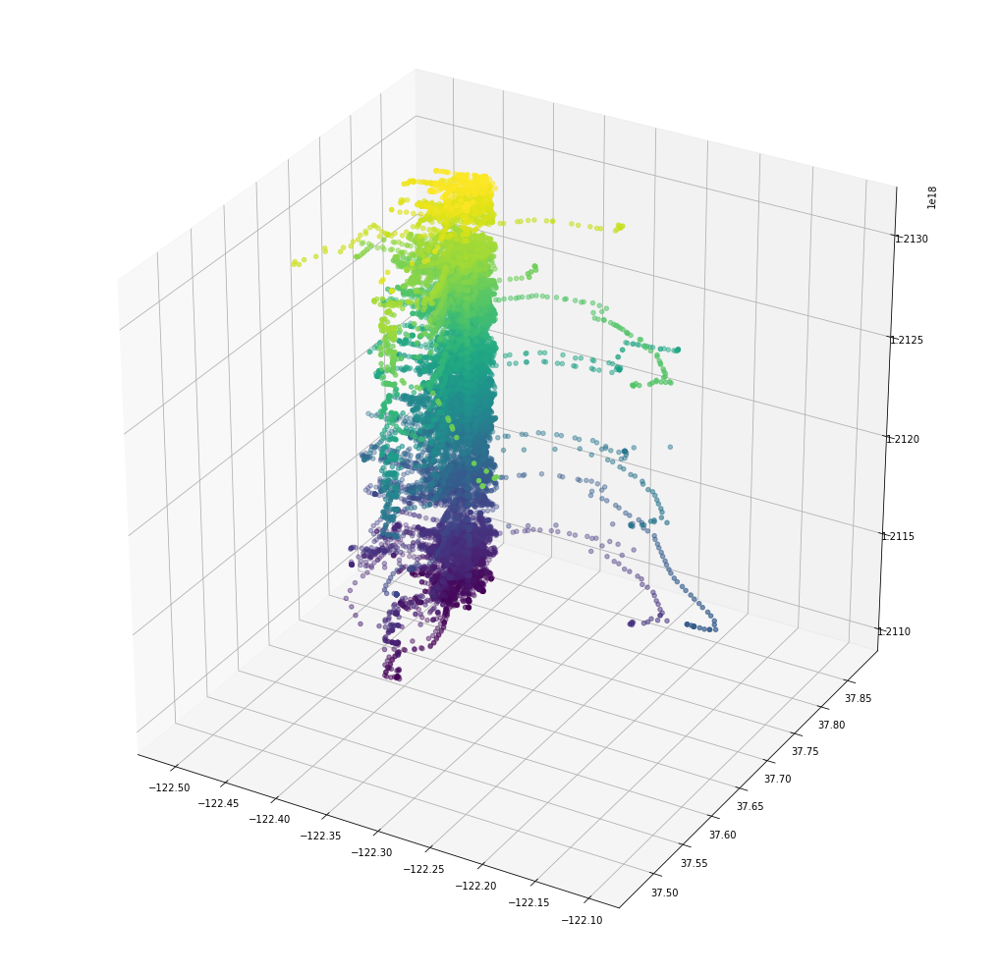

In [79]:
fig = plt.figure(figsize=(18, 18))
ax = fig.gca(projection='3d')
ax.scatter(df_abboip['longitude'], df_abboip['latitude'], df_abboip.index.to_series(), c=df_abboip.index.to_series())

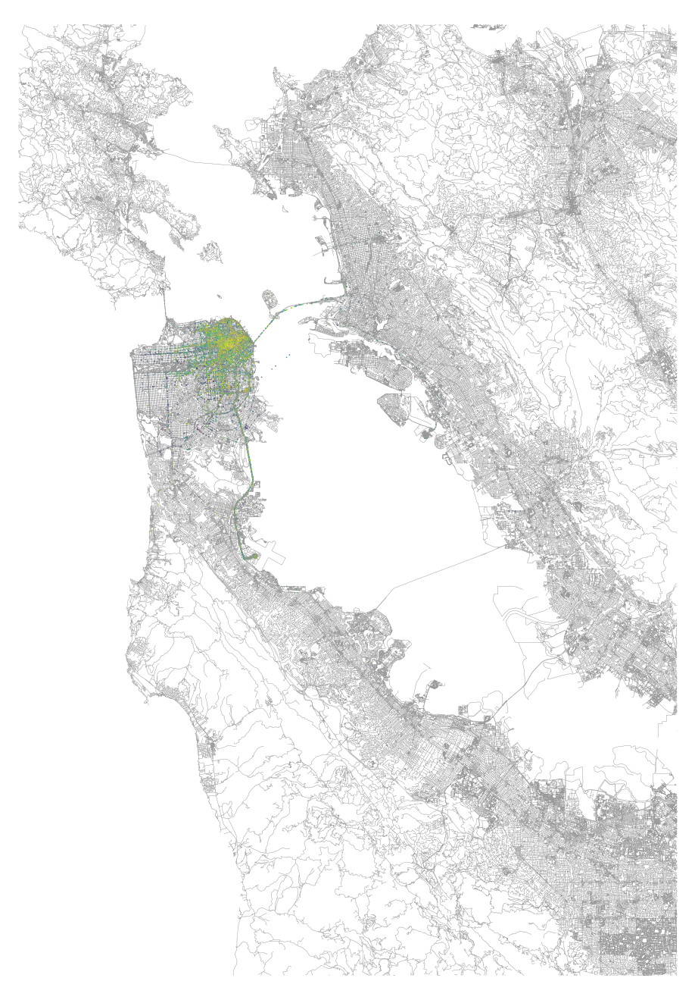

In [73]:
fig, ax = ox.plot_graph(streets, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
ax.scatter(df_abboip['longitude'], df_abboip['latitude'], c=df_abboip.index.to_series(), s=0.25, alpha=1.0)

In [8]:
df_abboip['hour'] = df_abboip.index.to_series().dt.hour

In [83]:
df_abboip.head()

,latitude,longitude,occupied,hour
time,,,,
2008-05-17 14:12:10,37.75153,-122.39447,0,14
2008-05-17 14:13:34,37.75149,-122.39447,0,14
2008-05-17 14:14:34,37.75149,-122.39447,0,14
2008-05-17 14:15:35,37.75149,-122.39446,0,14
2008-05-17 14:41:43,37.75144,-122.39449,0,14


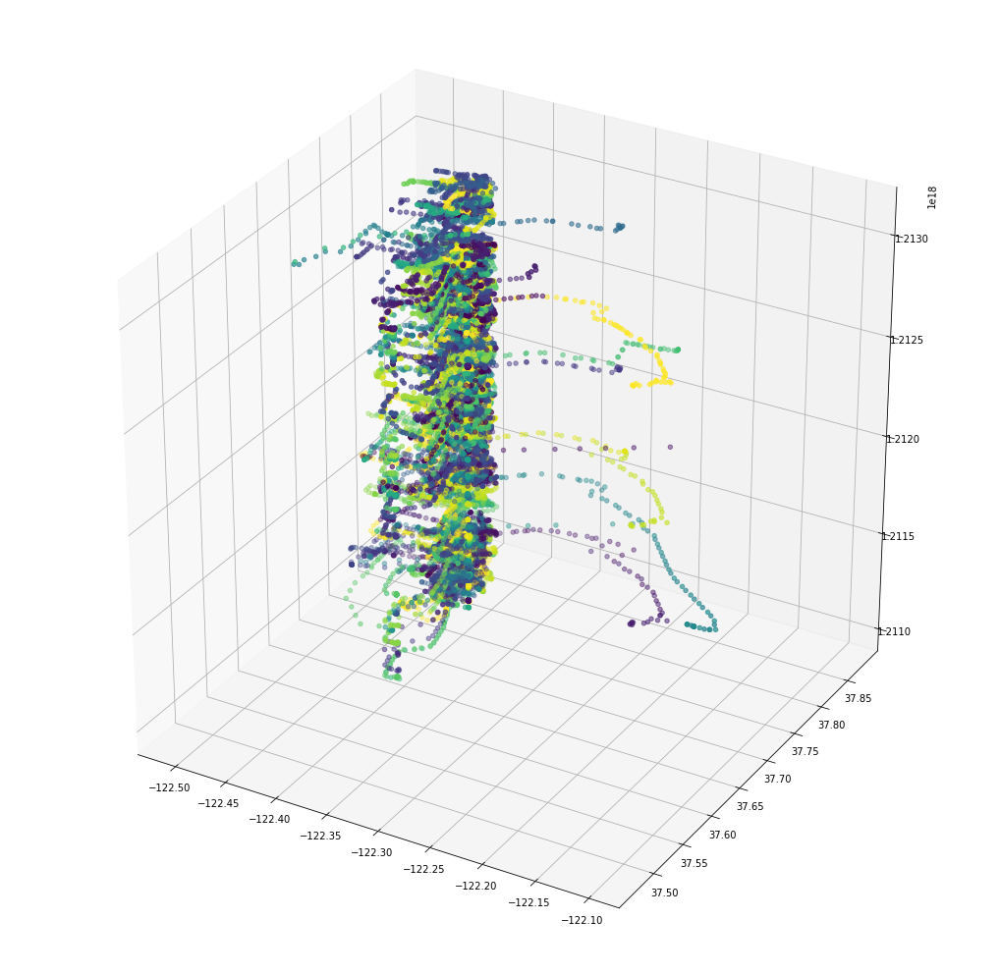

In [85]:
fig = plt.figure(figsize=(18, 18))
ax = fig.gca(projection='3d')
ax.scatter(df_abboip['longitude'], df_abboip['latitude'], df_abboip.index.to_series(), c=df_abboip['hour'])

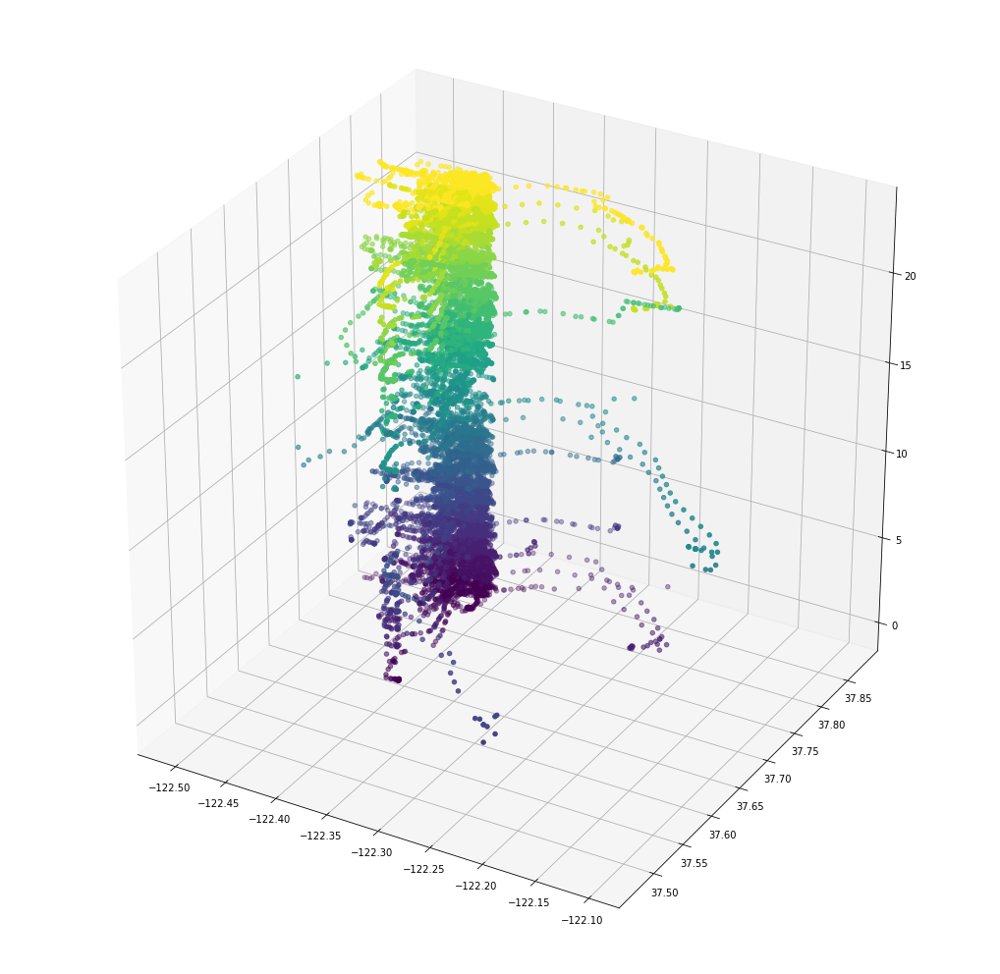

In [86]:
fig = plt.figure(figsize=(18, 18))
ax = fig.gca(projection='3d')
ax.scatter(df_abboip['longitude'], df_abboip['latitude'], df_abboip['hour'], c=df_abboip['hour'])

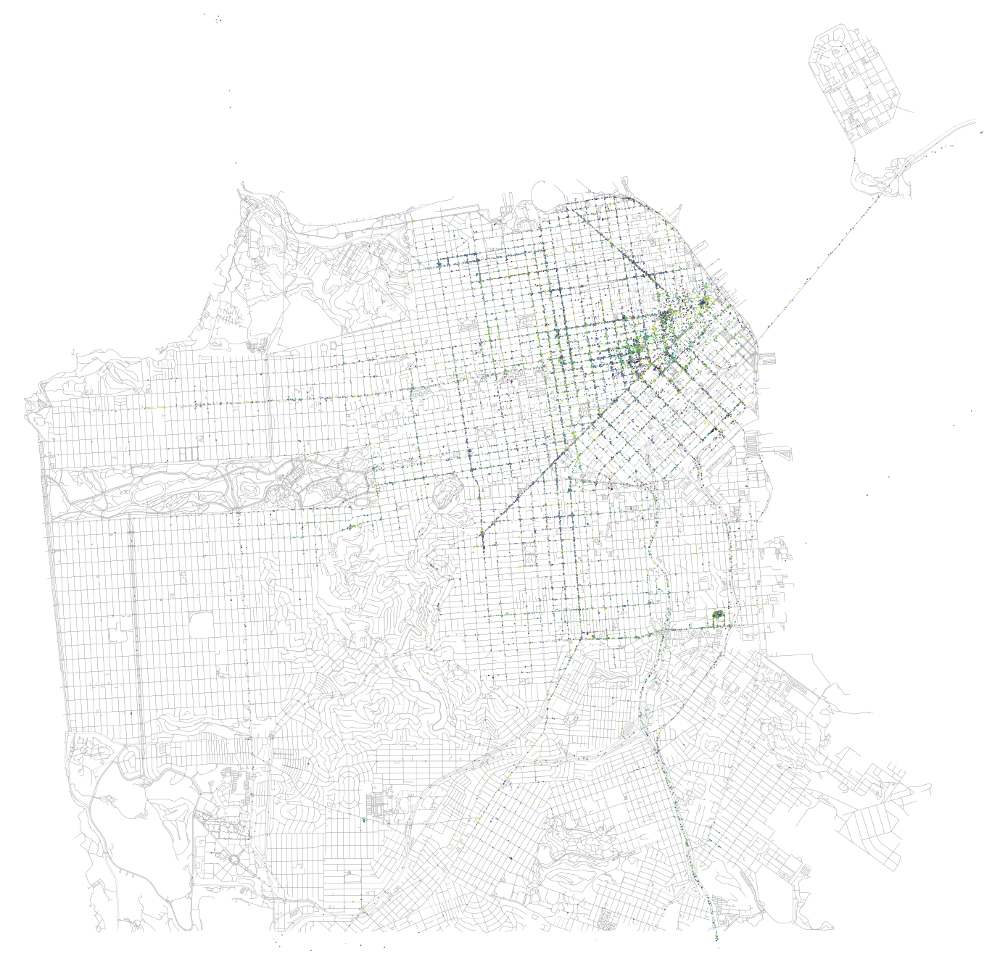

In [114]:
fig, ax = ox.plot_graph(streets_small, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
ax.scatter(df_abboip['longitude'], df_abboip['latitude'], c=df_abboip['hour'], s=0.25, alpha=1.0)

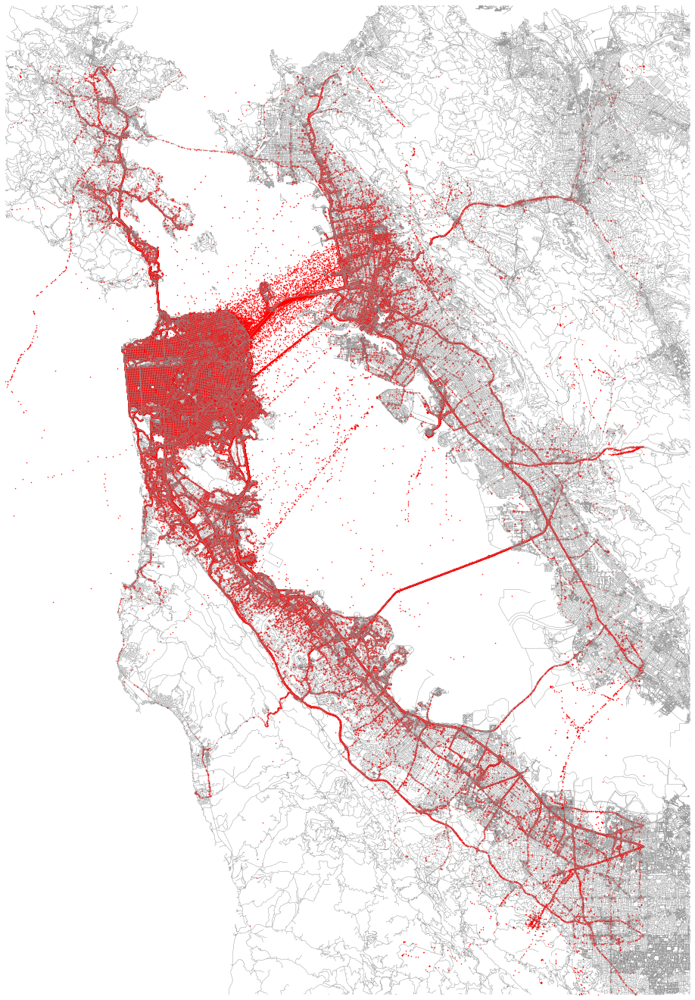

In [9]:
fig, ax = ox.plot_graph(streets, fig_height=24, node_size=0, edge_linewidth=0.25, margin=0.0,
                        show=False, close=False)
ax.scatter(df['longitude'], df['latitude'], c='#ff0000', s=0.25, alpha=1.0)

plt.savefig('../Images/overview_cabspotting_wide.png', dpi=200, bbox_inches='tight')

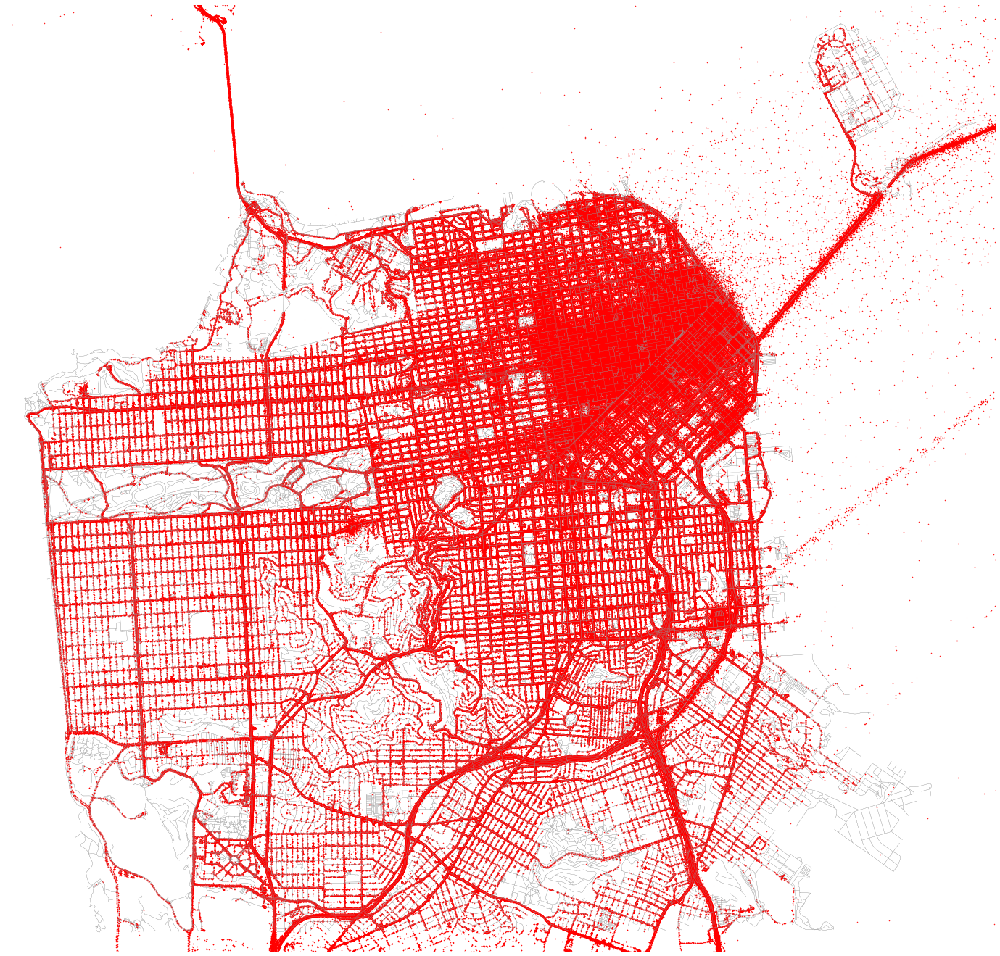

In [104]:
fig, ax = ox.plot_graph(streets_small, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
ax.scatter(df['longitude'], df['latitude'], c='#ff0000', s=0.25, alpha=1.0)

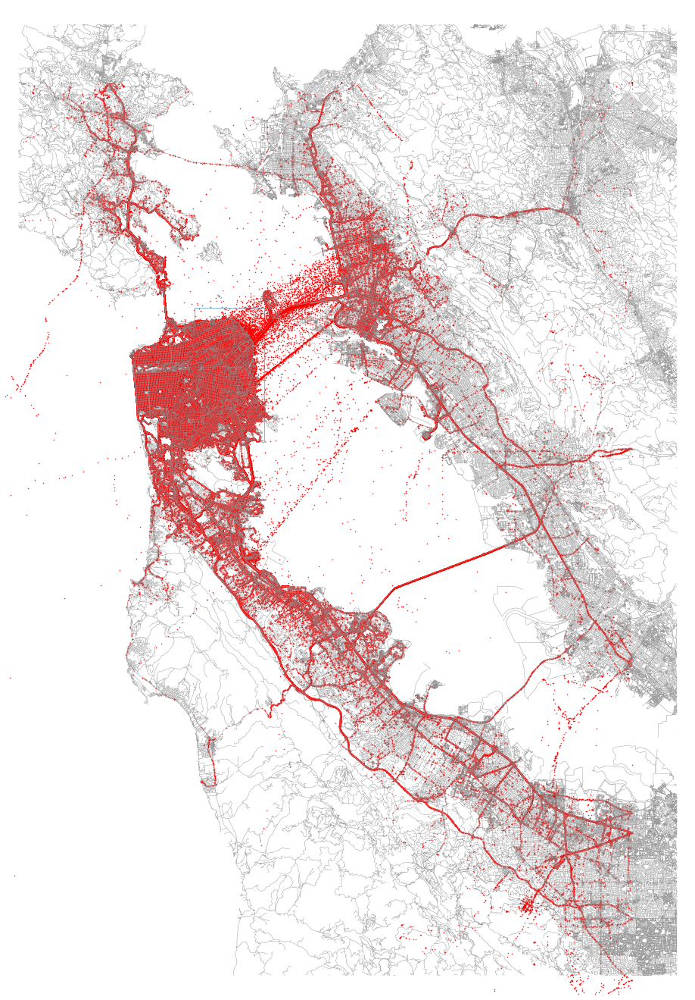

In [96]:
fig, ax = ox.plot_graph(streets, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
ax.scatter(df['longitude'], df['latitude'], c='#ff0000', s=0.25, alpha=1.0)

std_north = df['latitude'].mean() + df['latitude'].std()
std_south = df['latitude'].mean() - df['latitude'].std()
std_east = df['longitude'].mean() - df['longitude'].std()
std_west = df['longitude'].mean() + df['longitude'].std()
std_lats = [std_north, std_south, std_south, std_north, std_north]
std_lons = [std_east, std_east, std_west, std_west, std_east]
ax.plot(std_lons, std_lats, linewidth=0.5, markersize=0)

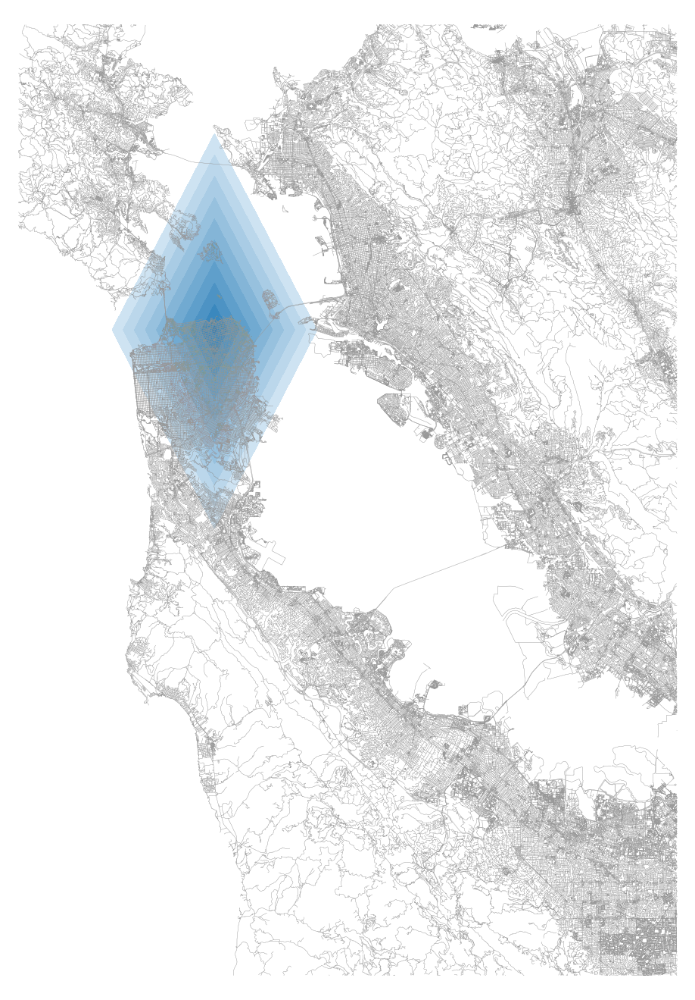

In [97]:
fig, ax = ox.plot_graph(streets, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
sns.kdeplot(df['longitude'], df['latitude'],
            shade=True, shade_lowest=False, ax=ax)

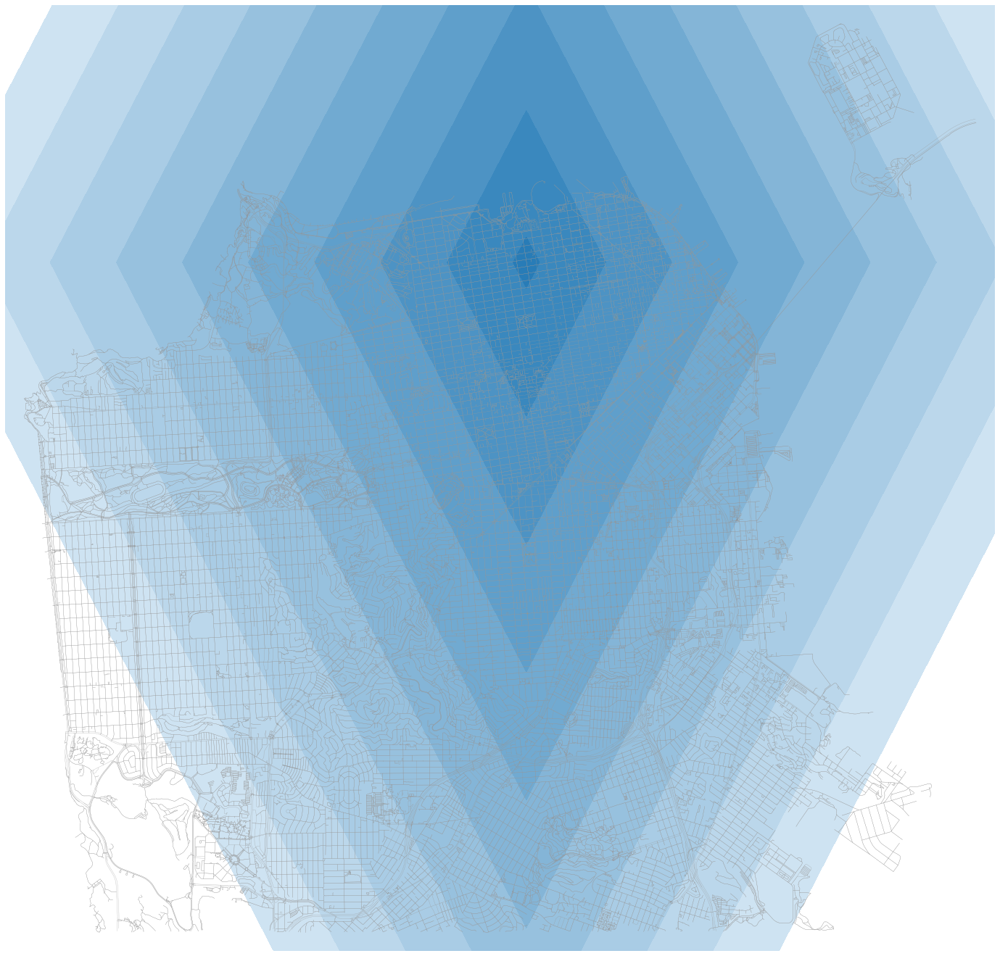

In [105]:
fig, ax = ox.plot_graph(streets_small, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
sns.kdeplot(df['longitude'], df['latitude'],
            shade=True, shade_lowest=False, ax=ax)

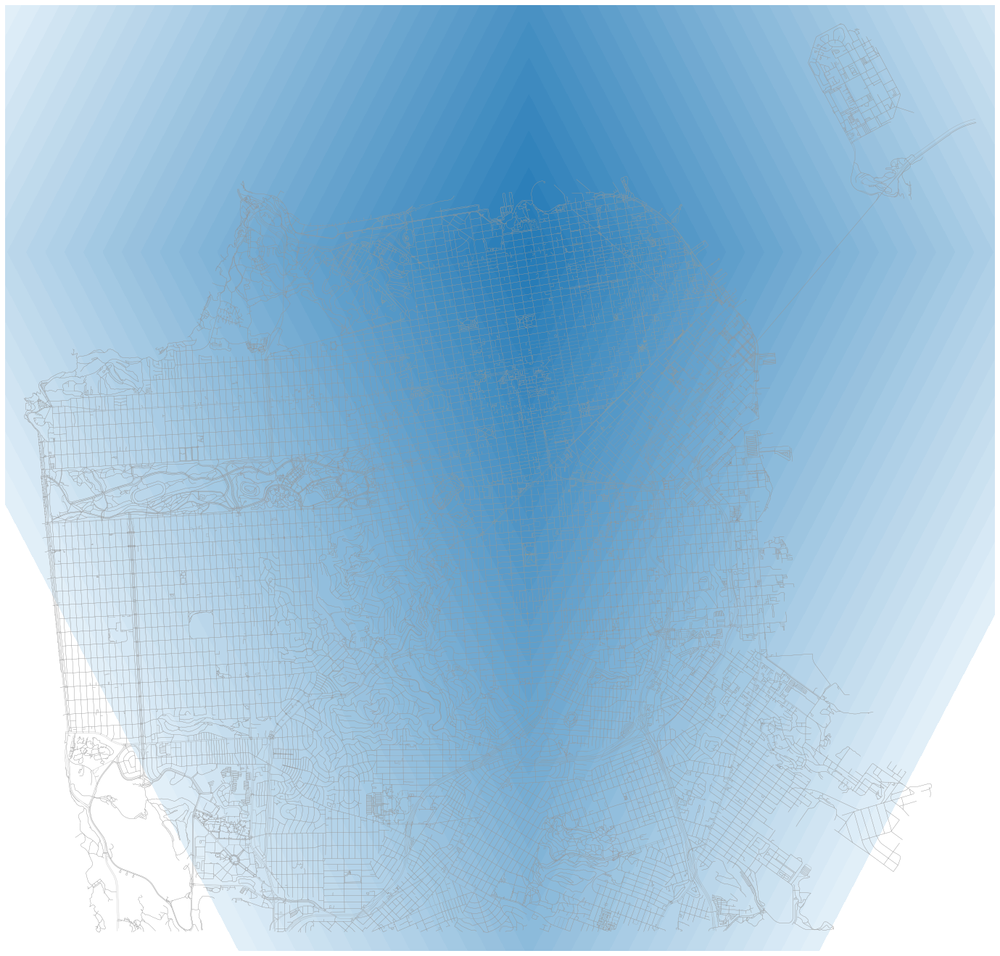

In [8]:
fig, ax = ox.plot_graph(streets_small, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
sns.kdeplot(df['longitude'], df['latitude'],
            shade=True, shade_lowest=False, ax=ax, bw=0.0000003, n_levels=50)

In [9]:
kde = KernelDensity(bandwidth=0.003, metric='haversine')
kde.fit(df[['longitude', 'latitude']].values)

KernelDensity(algorithm='auto', atol=0, bandwidth=0.003, breadth_first=True,
       kernel='gaussian', leaf_size=40, metric='haversine',
       metric_params=None, rtol=0)

In [10]:
# Create evaluation grid
xgrid = np.linspace(sf_west, sf_east, 50)
ygrid = np.linspace(sf_south, sf_north, 50)
xs, ys = np.meshgrid(xgrid, ygrid)

xys = np.vstack([xs.ravel(), ys.ravel()]).T

In [11]:
# Evaluate on the grid
zs = np.exp(kde.score_samples(xys))
zs = zs.reshape(xs.shape)

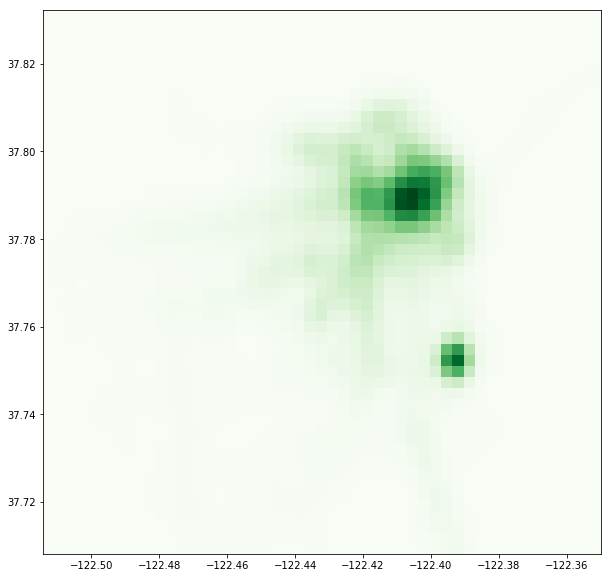

In [12]:
plt.figure(figsize=(10, 10))
plt.pcolormesh(xs, ys, zs, cmap=plt.cm.Greens)

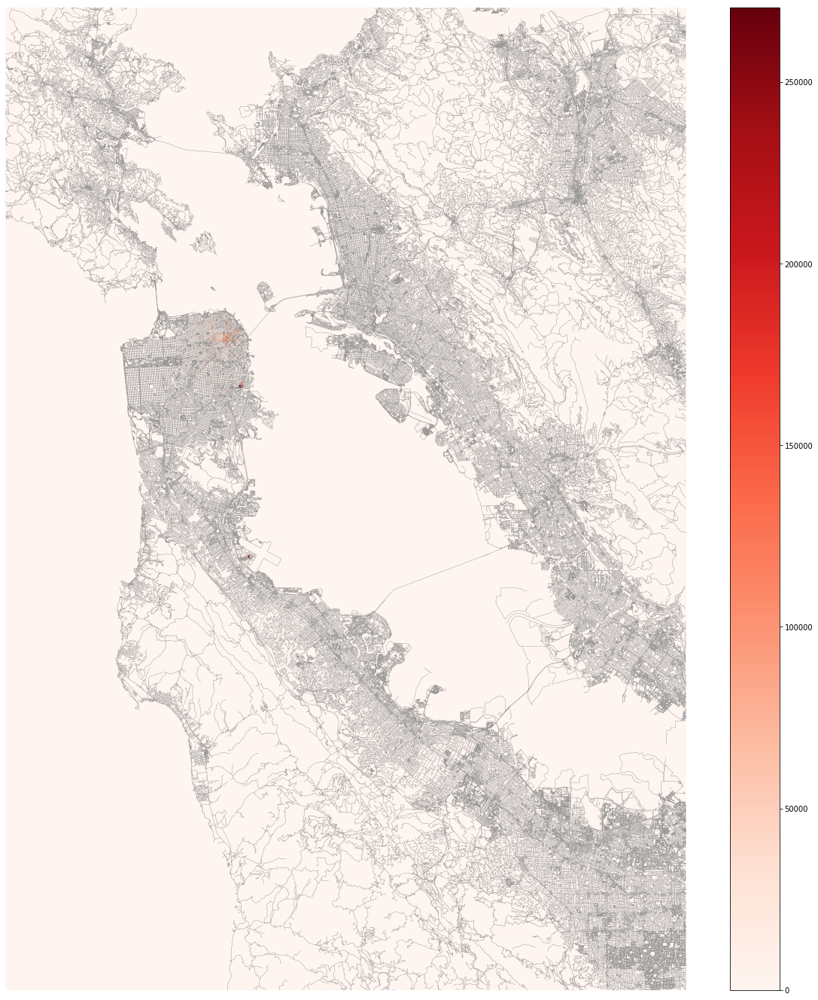

In [119]:
fig, ax = ox.plot_graph(streets, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
plt.hist2d(df['longitude'], df['latitude'],
           bins=(300, 300), cmap=plt.cm.Reds, range=[[west, east], [south, north]])
plt.colorbar()

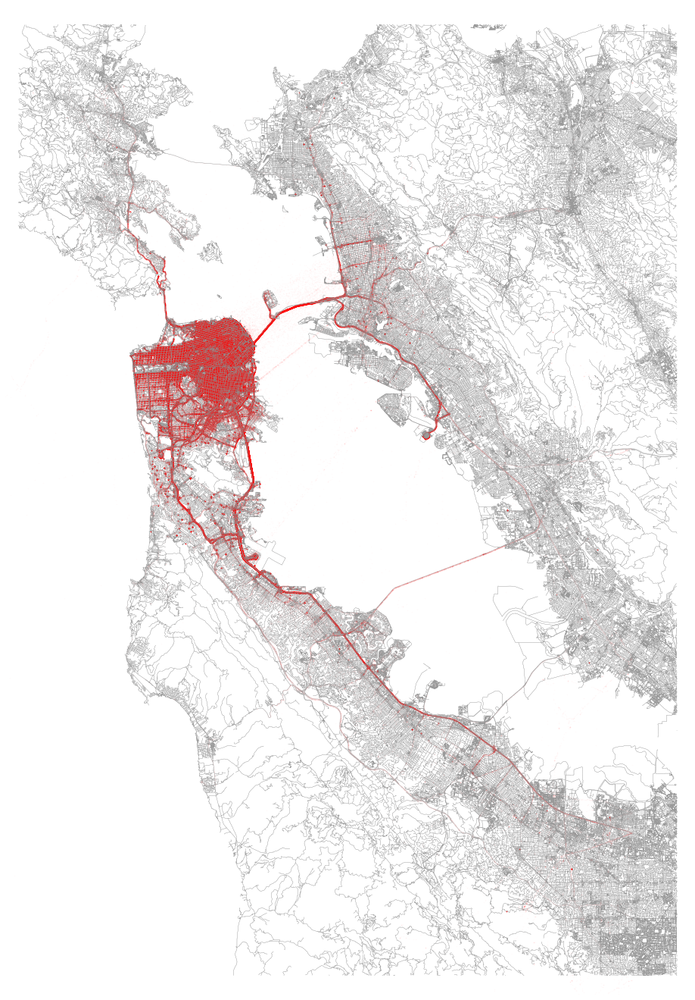

In [7]:
fig, ax = ox.plot_graph(streets, fig_height=24, node_size=0, edge_linewidth=0.25, show=False, close=False)
ax.scatter(df['longitude'], df['latitude'], c='#ff0000', s=0.25, alpha=0.02)

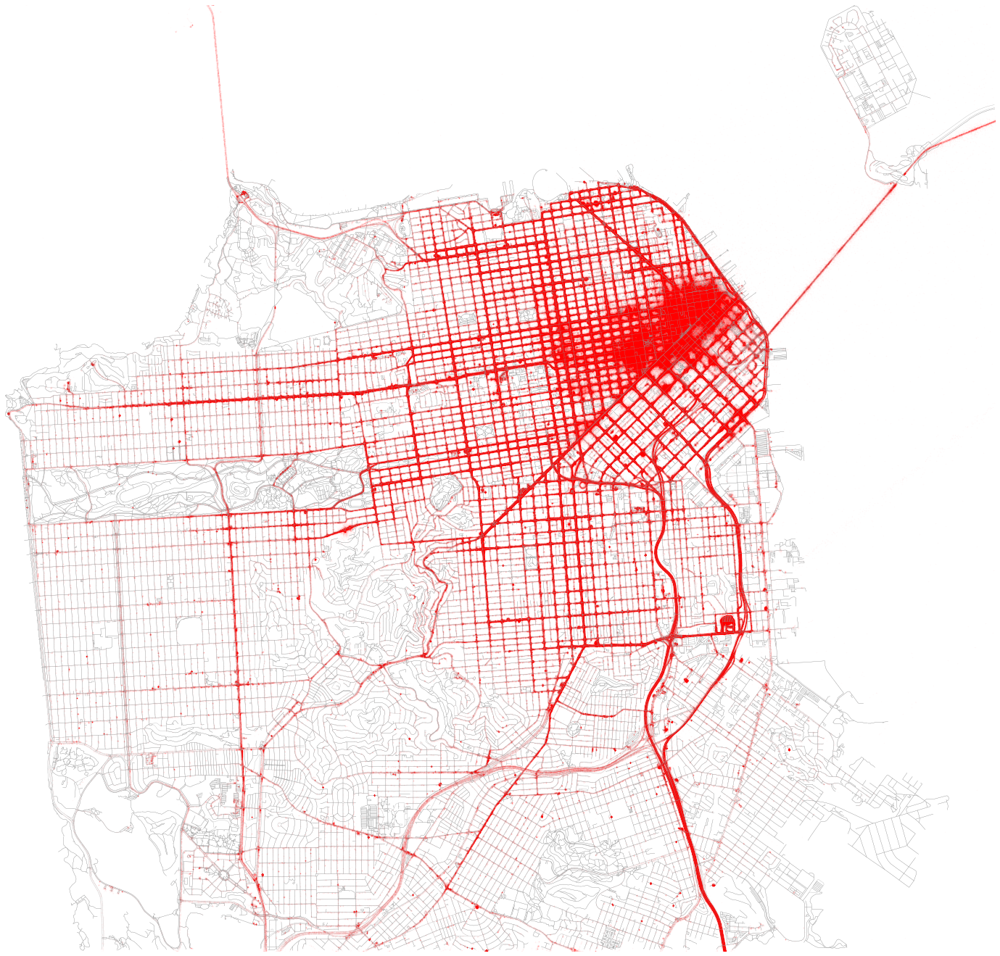

In [10]:
fig, ax = ox.plot_graph(streets_small, fig_height=24, node_size=0, edge_linewidth=0.25, margin=0.0,
                        show=False, close=False)
ax.scatter(df['longitude'], df['latitude'], c='#ff0000', s=0.25, alpha=0.02)

plt.savefig('../Images/overview_cabspotting_alpha.png', dpi=100, bbox_inches='tight')